In [1]:
import pm4py
import pandas as pd
import sys as os

In [2]:
xes_file = 'file\PrepaidTravelCost.xes\PrepaidTravelCost.xes'
log = pm4py.read_xes(xes_file)
df = pm4py.convert_to_dataframe(log)
df.to_csv('file\PrepaidTravelCost.xes\PrepaidTravelCost.csv')

c:\Users\mikdr\OneDrive - Università Politecnica delle Marche\ProgettoPotena\BigData\.venv\lib\site-packages\pm4py\util\dt_parsing\parser.py:82: UserWarning: ISO8601 strings are not fully supported with strpfromiso for Python versions below 3.11
  warnings.warn(
c:\Users\mikdr\OneDrive - Università Politecnica delle Marche\ProgettoPotena\BigData\.venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
parsing log, completed traces :: 100%|██████████| 2099/2099 [00:01<00:00, 1940.91it/s]


In [3]:
df

,id,org:resource,concept:name,time:timestamp,org:role,case:Rfp_id,case:Permit travel permit number,case:Task,case:OrganizationalEntity,case:RequestedAmount,...,case:Permit BudgetNumber,case:Permit ProjectNumber,case:Project,case:concept:name,case:Permit OrganizationalEntity,case:Permit RequestedBudget,case:Cost Type,case:Permit id,case:Permit ActivityNumber,case:RfpNumber
0,st_step 73555_0,STAFF MEMBER,Permit SUBMITTED by EMPLOYEE,2017-01-09 14:48:43+00:00,EMPLOYEE,request for payment 73550,UNKNOWN,task 71977,organizational unit 65463,854.579838,...,budget 6198,UNKNOWN,project 503,request for payment 73550,organizational unit 65455,1979.272104,0,travel permit 73549,UNKNOWN,request for payment number 73551
1,st_step 73554_0,STAFF MEMBER,Permit FINAL_APPROVED by SUPERVISOR,2017-01-09 14:48:55+00:00,SUPERVISOR,request for payment 73550,UNKNOWN,task 71977,organizational unit 65463,854.579838,...,budget 6198,UNKNOWN,project 503,request for payment 73550,organizational unit 65455,1979.272104,0,travel permit 73549,UNKNOWN,request for payment number 73551
2,st_step 73558_0,STAFF MEMBER,Request For Payment SUBMITTED by EMPLOYEE,2017-01-12 11:40:27+00:00,EMPLOYEE,request for payment 73550,UNKNOWN,task 71977,organizational unit 65463,854.579838,...,budget 6198,UNKNOWN,project 503,request for payment 73550,organizational unit 65455,1979.272104,0,travel permit 73549,UNKNOWN,request for payment number 73551
3,st_step 73559_0,STAFF MEMBER,Request For Payment FINAL_APPROVED by SUPERVISOR,2017-01-12 11:41:59+00:00,SUPERVISOR,request for payment 73550,UNKNOWN,task 71977,organizational unit 65463,854.579838,...,budget 6198,UNKNOWN,project 503,request for payment 73550,organizational unit 65455,1979.272104,0,travel permit 73549,UNKNOWN,request for payment number 73551
4,st_step 73557_0,STAFF MEMBER,Request For Payment REJECTED by MISSING,2017-01-12 11:53:07+00:00,MISSING,request for payment 73550,UNKNOWN,task 71977,organizational unit 65463,854.579838,...,budget 6198,UNKNOWN,project 503,request for payment 73550,organizational unit 65455,1979.272104,0,travel permit 73549,UNKNOWN,request for payment number 73551
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18241,st_step 186614_0,STAFF MEMBER,Request For Payment SUBMITTED by EMPLOYEE,2018-12-30 20:16:15+00:00,EMPLOYEE,request for payment 186612,UNKNOWN,UNKNOWN,organizational unit 65462,96.739075,...,UNKNOWN,UNKNOWN,project 147531,request for payment 186612,UNKNOWN,0.000000,0,UNKNOWN,UNKNOWN,request for payment number 186613
18242,st_step 186616_0,STAFF MEMBER,Request For Payment APPROVED by ADMINISTRATION,2018-12-30 20:16:25+00:00,ADMINISTRATION,request for payment 186612,UNKNOWN,UNKNOWN,organizational unit 65462,96.739075,...,UNKNOWN,UNKNOWN,project 147531,request for payment 186612,UNKNOWN,0.000000,0,UNKNOWN,UNKNOWN,request for payment number 186613
18243,st_step 186615_0,STAFF MEMBER,Request For Payment FINAL_APPROVED by SUPERVISOR,2019-01-14 15:09:11+00:00,SUPERVISOR,request for payment 186612,UNKNOWN,UNKNOWN,organizational unit 65462,96.739075,...,UNKNOWN,UNKNOWN,project 147531,request for payment 186612,UNKNOWN,0.000000,0,UNKNOWN,UNKNOWN,request for payment number 186613
18244,rp_request for payment 186612_15,SYSTEM,Request Payment,2019-01-15 07:02:45+00:00,UNDEFINED,request for payment 186612,UNKNOWN,UNKNOWN,organizational unit 65462,96.739075,...,UNKNOWN,UNKNOWN,project 147531,request for payment 186612,UNKNOWN,0.000000,0,UNKNOWN,UNKNOWN,request for payment number 186613


In [4]:

print(df.columns)
#need: case:Rfp_id	(trace_id), concept:name(name activity), time:timestamp(end time of activity), org:role(resource that performed the activity). 
#In event insert column result (success, failed)

Index(['id', 'org:resource', 'concept:name', 'time:timestamp', 'org:role',
       'case:Rfp_id', 'case:Permit travel permit number', 'case:Task',
       'case:OrganizationalEntity', 'case:RequestedAmount', 'case:Activity',
       'case:Permit TaskNumber', 'case:Permit BudgetNumber',
       'case:Permit ProjectNumber', 'case:Project', 'case:concept:name',
       'case:Permit OrganizationalEntity', 'case:Permit RequestedBudget',
       'case:Cost Type', 'case:Permit id', 'case:Permit ActivityNumber',
       'case:RfpNumber'],
      dtype='object')


In [5]:
#ENTITIES: case, event, resource
#RELATIONSHIP: composed (btw case and event), achieve (btw event and resource)

In [6]:
#Make new column for event id
id = df[['concept:name']].drop_duplicates().reset_index(drop=True)
id['event:id'] = id.index
id

,concept:name,event:id
0,Permit SUBMITTED by EMPLOYEE,0
1,Permit FINAL_APPROVED by SUPERVISOR,1
2,Request For Payment SUBMITTED by EMPLOYEE,2
3,Request For Payment FINAL_APPROVED by SUPERVISOR,3
4,Request For Payment REJECTED by MISSING,4
5,Permit REJECTED by MISSING,5
6,Request Payment,6
7,Payment Handled,7
8,Permit APPROVED by SUPERVISOR,8
9,Permit FINAL_APPROVED by DIRECTOR,9


In [7]:
#Make event File
make_event = df[['case:Rfp_id', 'concept:name', 'time:timestamp', 'org:role']] 
make_event  
#Rename column timestamp
make_event.rename(columns={'time:timestamp':'time:timestamp_end'}, inplace=True) 

C:\Users\mikdr\AppData\Local\Temp\ipykernel_24472\960767573.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  make_event.rename(columns={'time:timestamp':'time:timestamp_end'}, inplace=True)


In [8]:
#Associate event id to concept name
make_event = make_event.merge(id, on='concept:name')
make_event

,case:Rfp_id,concept:name,time:timestamp_end,org:role,event:id
0,request for payment 73550,Permit SUBMITTED by EMPLOYEE,2017-01-09 14:48:43+00:00,EMPLOYEE,0
1,request for payment 73550,Permit FINAL_APPROVED by SUPERVISOR,2017-01-09 14:48:55+00:00,SUPERVISOR,1
2,request for payment 73550,Request For Payment SUBMITTED by EMPLOYEE,2017-01-12 11:40:27+00:00,EMPLOYEE,2
3,request for payment 73550,Request For Payment FINAL_APPROVED by SUPERVISOR,2017-01-12 11:41:59+00:00,SUPERVISOR,3
4,request for payment 73550,Request For Payment REJECTED by MISSING,2017-01-12 11:53:07+00:00,MISSING,4
...,...,...,...,...,...
18241,request for payment 186612,Request For Payment SUBMITTED by EMPLOYEE,2018-12-30 20:16:15+00:00,EMPLOYEE,2
18242,request for payment 186612,Request For Payment APPROVED by ADMINISTRATION,2018-12-30 20:16:25+00:00,ADMINISTRATION,21
18243,request for payment 186612,Request For Payment FINAL_APPROVED by SUPERVISOR,2019-01-14 15:09:11+00:00,SUPERVISOR,3
18244,request for payment 186612,Request Payment,2019-01-15 07:02:45+00:00,UNDEFINED,6


In [9]:
#Make file Case
make_case = df[['case:Rfp_id']].drop_duplicates().reset_index(drop=True)
csv_case = make_case.to_csv('file\case.csv')

In [10]:
#Make file Resource
make_resource = df[['org:role']].drop_duplicates().reset_index(drop=True)
csv_resource = make_resource.to_csv(r'file\resource.csv')

In [11]:
#Make column time:timestamp_start. Start time is the end of previous activity
make_event['time:timestamp_start'] = make_event.groupby('case:Rfp_id')['time:timestamp_end'].shift(1)
#Where timestamp_start is NaT, replace with timestamp_end
make_event['time:timestamp_start'] = make_event['time:timestamp_start'].fillna(make_event['time:timestamp_end'])
make_event

,case:Rfp_id,concept:name,time:timestamp_end,org:role,event:id,time:timestamp_start
0,request for payment 73550,Permit SUBMITTED by EMPLOYEE,2017-01-09 14:48:43+00:00,EMPLOYEE,0,2017-01-09 14:48:43+00:00
1,request for payment 73550,Permit FINAL_APPROVED by SUPERVISOR,2017-01-09 14:48:55+00:00,SUPERVISOR,1,2017-01-09 14:48:43+00:00
2,request for payment 73550,Request For Payment SUBMITTED by EMPLOYEE,2017-01-12 11:40:27+00:00,EMPLOYEE,2,2017-01-09 14:48:55+00:00
3,request for payment 73550,Request For Payment FINAL_APPROVED by SUPERVISOR,2017-01-12 11:41:59+00:00,SUPERVISOR,3,2017-01-12 11:40:27+00:00
4,request for payment 73550,Request For Payment REJECTED by MISSING,2017-01-12 11:53:07+00:00,MISSING,4,2017-01-12 11:41:59+00:00
...,...,...,...,...,...,...
18241,request for payment 186612,Request For Payment SUBMITTED by EMPLOYEE,2018-12-30 20:16:15+00:00,EMPLOYEE,2,2018-12-30 20:16:15+00:00
18242,request for payment 186612,Request For Payment APPROVED by ADMINISTRATION,2018-12-30 20:16:25+00:00,ADMINISTRATION,21,2018-12-30 20:16:15+00:00
18243,request for payment 186612,Request For Payment FINAL_APPROVED by SUPERVISOR,2019-01-14 15:09:11+00:00,SUPERVISOR,3,2018-12-30 20:16:25+00:00
18244,request for payment 186612,Request Payment,2019-01-15 07:02:45+00:00,UNDEFINED,6,2019-01-14 15:09:11+00:00


In [12]:
csv_event = make_event.to_csv('file\events.csv')

parsing log, completed traces :: 100%|██████████| 2099/2099 [00:00<00:00, 2102.81it/s]


                                     id  org:resource  \
0                       st_step 73555_0  STAFF MEMBER   
1                       st_step 73554_0  STAFF MEMBER   
2                       st_step 73558_0  STAFF MEMBER   
3                       st_step 73559_0  STAFF MEMBER   
4                       st_step 73557_0  STAFF MEMBER   
...                                 ...           ...   
18241                  st_step 186614_0  STAFF MEMBER   
18242                  st_step 186616_0  STAFF MEMBER   
18243                  st_step 186615_0  STAFF MEMBER   
18244  rp_request for payment 186612_15        SYSTEM   
18245  rp_request for payment 186612_16        SYSTEM   

                                           concept:name  \
0                          Permit SUBMITTED by EMPLOYEE   
1                   Permit FINAL_APPROVED by SUPERVISOR   
2             Request For Payment SUBMITTED by EMPLOYEE   
3      Request For Payment FINAL_APPROVED by SUPERVISOR   
4               Requ

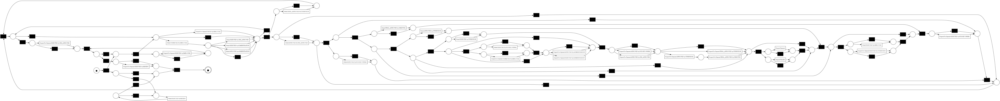

''

In [13]:
#Load the XES file
log = pm4py.read_xes("file/PrepaidTravelCost.xes/PrepaidTravelCost.xes")
print(log)
#Discover Petri net using the inductive miner
net, initial_marking, final_marking = pm4py.discover_petri_net_inductive(log)
#Visualize the Petri net
pm4py.view_petri_net(net, initial_marking, final_marking)
pm4py.save_vis_petri_net(net, initial_marking, final_marking, "file\img\petri_net.png")


In [14]:
#Given an event suggest all possible event that can be performed next
from pm4py.algo.filtering.log.start_activities import start_activities_filter

#Possible start of the log
log_start = pm4py.get_start_activities(log)
print(log_start)   
next_activity = {} 
for i in log_start:
    print("Possible start:", i)
    #Filter the log to get the traces that start with the given activity
    filtered_log = start_activities_filter.apply(log, [i])
    #print(len(filtered_log))
    #Avoid duplicates
    next_activity_set = set() 
    #For each trace in the filtered log, get the next activity --> [1] that is the second activity
    for trace in filtered_log: 
        if len(trace) > 1:
            #There we can put also event:id
            next_activity_set.add(trace[1]['concept:name'])
    
    next_activity[i] = list(next_activity_set)

print(next_activity)
#Request For Payment SAVED by EMPLOYEE probabilmente è un evento anomalo che quando starta finisce lì in qel momento

{'Permit SUBMITTED by EMPLOYEE': 1859, 'Request For Payment SUBMITTED by EMPLOYEE': 233, 'Request For Payment SAVED by EMPLOYEE': 7}
Possible start: Permit SUBMITTED by EMPLOYEE
Possible start: Request For Payment SUBMITTED by EMPLOYEE
Possible start: Request For Payment SAVED by EMPLOYEE
{'Permit SUBMITTED by EMPLOYEE': ['Permit APPROVED by SUPERVISOR', 'Permit REJECTED by ADMINISTRATION', 'Permit REJECTED by SUPERVISOR', 'Permit REJECTED by PRE_APPROVER', 'Permit APPROVED by ADMINISTRATION', 'Permit APPROVED by PRE_APPROVER', 'Permit FINAL_APPROVED by SUPERVISOR'], 'Request For Payment SUBMITTED by EMPLOYEE': ['Request For Payment APPROVED by ADMINISTRATION', 'Request For Payment REJECTED by PRE_APPROVER', 'Request For Payment FINAL_APPROVED by SUPERVISOR', 'Request For Payment REJECTED by ADMINISTRATION', 'Request For Payment APPROVED by PRE_APPROVER'], 'Request For Payment SAVED by EMPLOYEE': []}


In [25]:
#For every event, suggest all possible next event
#Take an event from event:id
#Make a dictionary initialited with the event:id as key and the value is a list of possible next event
next_event = {}
for i in make_event['event:id'].unique():
    print("Event name: ", make_event[make_event['event:id'] == i]['concept:name'].values[0], "; Event id: ", i)
    #For every i in make_event where event:id is i, get next event:id in the trace
    #Insert key i and value a empty list at the beginning
    next_event[i] = []
    print("Dizionario: ")
    print(next_event)
    for j in make_event[make_event['event:id'] == i]['case:Rfp_id']:
        #j is the trace id
        #Get the trace (through case:Rfp_id) where the event:id is i
        trace = make_event[make_event['case:Rfp_id'] == j]
        #print("Traccia: ", trace)
        #Find the index of the current event in the trace
        indices = trace[trace['event:id'] == i].index.tolist()
        
        for index in indices:
            #Check if the event is not the last in the trace
            if index < trace.index[-1]:
                #Get the next event:id
                next_event_id = trace.loc[index + 1]['event:id']
                #Append the next event to list if it is not already there
                if next_event_id not in next_event[i]:
                    next_event[i].append(next_event_id)
                else:
                    print(f"L'evento con indice {index} è già presente nella lista.")
            else:
                print(f"L'evento con indice {index} è l'ultimo nella traccia.")
    
#Clear dictionart from "np.int64" 
next_event = {int(key): [int(val) for val in values] for key, values in next_event.items()}
print(next_event)   

Event name:  Permit SUBMITTED by EMPLOYEE ; Event id:  0
Dizionario: 
{np.int64(0): []}
Traccia:                   case:Rfp_id  \
0  request for payment 73550   
1  request for payment 73550   
2  request for payment 73550   
3  request for payment 73550   
4  request for payment 73550   
5  request for payment 73550   

                                       concept:name        time:timestamp_end  \
0                      Permit SUBMITTED by EMPLOYEE 2017-01-09 14:48:43+00:00   
1               Permit FINAL_APPROVED by SUPERVISOR 2017-01-09 14:48:55+00:00   
2         Request For Payment SUBMITTED by EMPLOYEE 2017-01-12 11:40:27+00:00   
3  Request For Payment FINAL_APPROVED by SUPERVISOR 2017-01-12 11:41:59+00:00   
4           Request For Payment REJECTED by MISSING 2017-01-12 11:53:07+00:00   
5                        Permit REJECTED by MISSING 2017-07-28 10:10:18+00:00   

     org:role  event:id      time:timestamp_start  
0    EMPLOYEE         0 2017-01-09 14:48:43+00:00  
1  SU

In [30]:
#Write dictionary on json file prettified
import json
with open('file/doc/next_event.json', 'w') as f:
    json.dump(next_event, f, indent=1)


In [16]:
#Suggest which one is the most convenient among all the possible ones

In [17]:
#Insert new resource

In [18]:
#Insert new event

In [19]:
#Insert new case